# Exploratory Data Analysis

In [ ]:
# copying zip file to google colab

!cp -r '/content/drive/MyDrive/RDD/train.tar.gz' '/content/'

In [ ]:
# unzipping the zipped file

!tar -xvf  'train.tar.gz'

Streaming output truncated to the last 5000 lines.
train/Japan/annotations/xmls/Japan_009766.xml
train/Japan/annotations/xmls/Japan_006254.xml
train/Japan/annotations/xmls/Japan_008726.xml
train/Japan/annotations/xmls/Japan_004664.xml
train/Japan/annotations/xmls/Japan_007945.xml
train/Japan/annotations/xmls/Japan_006391.xml
train/Japan/annotations/xmls/Japan_005903.xml
train/Japan/annotations/xmls/Japan_008200.xml
train/Japan/annotations/xmls/Japan_003663.xml
train/Japan/annotations/xmls/Japan_001949.xml
train/Japan/annotations/xmls/Japan_011141.xml
train/Japan/annotations/xmls/Japan_003141.xml
train/Japan/annotations/xmls/Japan_002870.xml
train/Japan/annotations/xmls/Japan_008094.xml
train/Japan/annotations/xmls/Japan_007381.xml
train/Japan/annotations/xmls/Japan_012963.xml
train/Japan/annotations/xmls/Japan_007843.xml
train/Japan/annotations/xmls/Japan_004889.xml
train/Japan/annotations/xmls/Japan_011099.xml
train/Japan/annotations/xmls/Japan_003745.xml
train/Japan/annotations/xmls/

In [ ]:
# importing important libararies

import os
import pandas as pd
from PIL import Image
import xml.etree.ElementTree as ET
import cv2

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def binder(base_path, country):
  '''
  This function is used to create two lists, one for containing all images and another for all annotations.
  Parameters : base_path - string and country - string 
  Return : two lists - all_images and all_annotations
  '''

  all_images = []
  all_annotations = []

  for each_image in sorted(os.listdir(base_path + country + '/' + 'images')):
    new_image_path = base_path + country + '/' + 'images' + '/' + each_image
    all_images.append(new_image_path)

  for each_xml in sorted(os.listdir(base_path + country + '/' + 'annotations' + '/' + 'xmls')):
    new_xml_path = base_path + country + '/' + 'annotations' + '/' + 'xmls' + '/' + each_xml
    all_annotations.append(new_xml_path)

  return all_images, all_annotations

In [ ]:
# collecting images and annotations corresponding to a particular country
czech_imgs, czech_annots = binder('train/', 'Czech')
india_imgs, india_annots = binder('train/', 'India')
japan_imgs, japan_annots = binder('train/', 'Japan')

# combining all the images and annotations
all_imgs = czech_imgs + india_imgs + japan_imgs
print(len(all_imgs))
print(all_imgs[:10])

print('*' * 50)

all_annots = czech_annots + india_annots + japan_annots
print(len(all_annots))
print(all_annots[:10])

21041
['train/Czech/images/Czech_000000.jpg', 'train/Czech/images/Czech_000001.jpg', 'train/Czech/images/Czech_000002.jpg', 'train/Czech/images/Czech_000006.jpg', 'train/Czech/images/Czech_000007.jpg', 'train/Czech/images/Czech_000009.jpg', 'train/Czech/images/Czech_000010.jpg', 'train/Czech/images/Czech_000011.jpg', 'train/Czech/images/Czech_000012.jpg', 'train/Czech/images/Czech_000013.jpg']
**************************************************
21041
['train/Czech/annotations/xmls/Czech_000000.xml', 'train/Czech/annotations/xmls/Czech_000001.xml', 'train/Czech/annotations/xmls/Czech_000002.xml', 'train/Czech/annotations/xmls/Czech_000006.xml', 'train/Czech/annotations/xmls/Czech_000007.xml', 'train/Czech/annotations/xmls/Czech_000009.xml', 'train/Czech/annotations/xmls/Czech_000010.xml', 'train/Czech/annotations/xmls/Czech_000011.xml', 'train/Czech/annotations/xmls/Czech_000012.xml', 'train/Czech/annotations/xmls/Czech_000013.xml']


In [ ]:
def checker(imgs, annots):
  '''
  This function is used to check whether the unique number of images is equal to unique number of xmls.
  Example : from Czech_000000.jpg, 000000 and from Czech_000000.xml, 000000
  Parameters : imgs - list and annots - list
  Return : count - interger, if count is not equal to 0 then somewhere unique numbers are not equal otherwise it's good.
  '''
  count = 0

  for i in zip(imgs, annots):
    img_term = i[0].split('_')
    annot_term = i[1].split('_')

    zeroth_img = img_term[-1].split('.')[0]
    zeroth_annot = annot_term[-1].split('.')[0]

    if not (zeroth_img == zeroth_annot):
      count += 1

  return count

In [ ]:
# checking whether images and annotations have same unique numbers or not

count = checker(all_imgs, all_annots)
print(count)

0


In [ ]:
# creating a dataframe by taking images and annotations as features

dataset = pd.DataFrame({'images' : all_imgs, 'annotations' : all_annots})
dataset.head()

,images,annotations
0,train/Czech/images/Czech_000000.jpg,train/Czech/annotations/xmls/Czech_000000.xml
1,train/Czech/images/Czech_000001.jpg,train/Czech/annotations/xmls/Czech_000001.xml
2,train/Czech/images/Czech_000002.jpg,train/Czech/annotations/xmls/Czech_000002.xml
3,train/Czech/images/Czech_000006.jpg,train/Czech/annotations/xmls/Czech_000006.xml
4,train/Czech/images/Czech_000007.jpg,train/Czech/annotations/xmls/Czech_000007.xml


In [ ]:
# saving dataframe for further reference

dataset.to_csv('drive/MyDrive/RDD/dataset.csv', index=False)

### Example - 1

This examples represents an image with no object detection in annotations.

In [ ]:
# reading xml file

with open('train/Czech/annotations/xmls/Czech_001153.xml', 'r') as f: 
    data = f.read()

print(data)

<annotation>
  <folder>images</folder>
  <filename>Czech_001153.jpg</filename>
  <size>
    <depth>3</depth>
    <width>600</width>
    <height>600</height>
  </size>
</annotation>


**Observation -** As we can see there is no tag with the name 'object', hence it means there is no damage detected. As we can see in the below image. Although I haven't implemented bounding box yet. One other thing to note down here is - For the entire Czech Republic data the image is represented by 600X600.

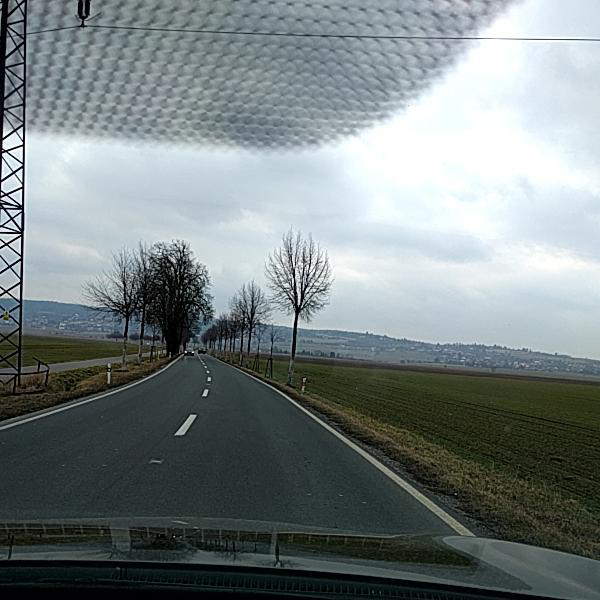

In [ ]:
# displaying image using PIL

img = Image.open('train/Czech/images/Czech_001153.jpg')
img

### Example - 2

This examples represents an image with object detection in annotations.

In [ ]:
# reading xml file

with open('train/India/annotations/xmls/India_003094.xml', 'r') as f: 
    data = f.read()

print(data)

<annotation>
	<folder>images</folder>
	<filename>India_003094.jpg</filename>
	<size>
		<width>720</width>
		<height>720</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>D01</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>128</xmin>
			<ymin>491</ymin>
			<xmax>291</xmax>
			<ymax>708</ymax>
		</bndbox>
	</object>
</annotation>


**Observation -** As we can see there is a tag with the name 'object', hence it means there is damage detected with the type 'D01'. As we can see in the below image. Although I haven't implemented bounding box yet. One other thing to note down here is - For the entire India data the image is represented by 720X720.

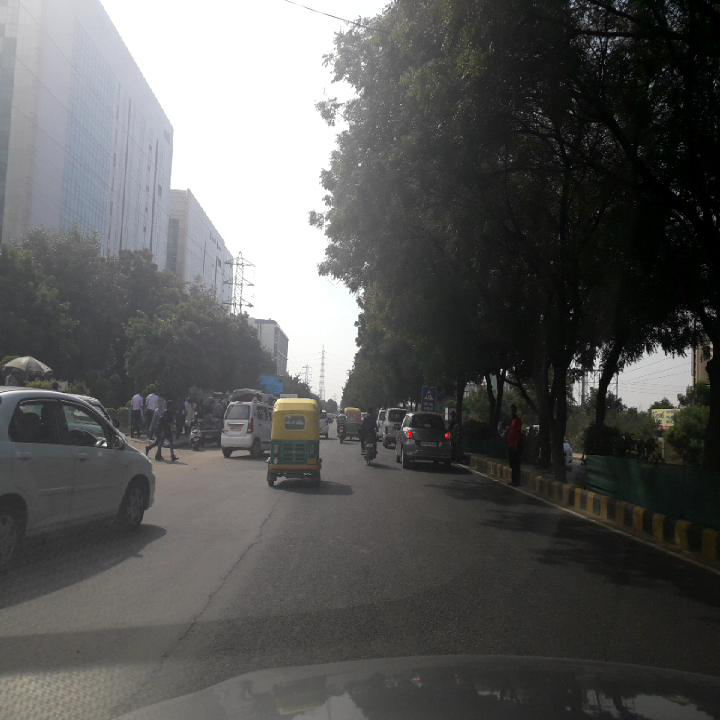

In [ ]:
# displaying image using PIL

img = Image.open('train/India/images/India_003094.jpg')
img

### Example - 3

This examples represents an image with multiple object detection in annotations.

In [ ]:
# reading xml file

with open('train/Japan/annotations/xmls/Japan_008472.xml', 'r') as f: 
    data = f.read()

print(data)

<annotation>
	<folder>images</folder>
	<filename>Japan_008472.jpg</filename>
	<size>
		<width>600</width>
		<height>600</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>D43</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>357</xmin>
			<ymin>449</ymin>
			<xmax>542</xmax>
			<ymax>594</ymax>
		</bndbox>
	</object>
	<object>
		<name>D50</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>294</xmin>
			<ymin>371</ymin>
			<xmax>338</xmax>
			<ymax>382</ymax>
		</bndbox>
	</object>
	<object>
		<name>D50</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>64</xmin>
			<ymin>344</ymin>
			<xmax>96</xmax>
			<ymax>359</ymax>
		</bndbox>
	</object>
</annotation>


**Observation -** As we can see there is a tag with the name 'object', hence it means there is damage detected with the type 'D43' and two times 'D50'. As we can see in the below image. Although I haven't implemented bounding box yet. One other thing to note down here is - For the entire Japan data the image is represented by 600X600.

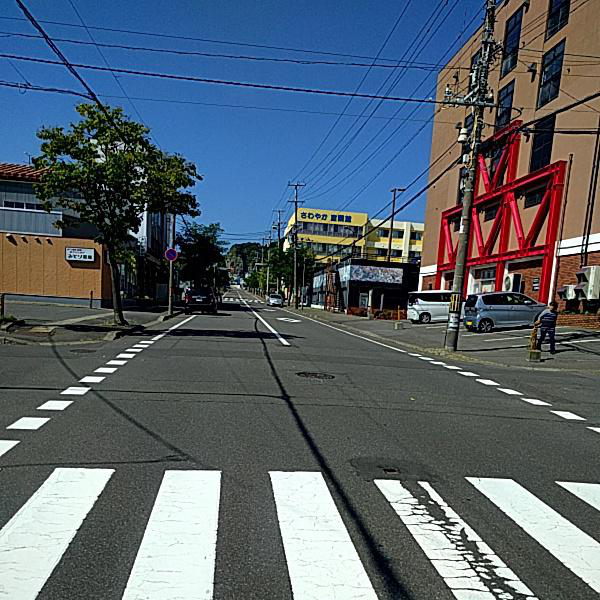

In [ ]:
# displaying image using PIL

img = Image.open('train/Japan/images/Japan_008472.jpg')
img

**As mentioned in the research paper, we can simply ignore damage types except than D00, D10, D20 and D40.** So I can split this entire process to two parts - first I can extract all the indexes where damage types same as given list and in the second step keeping those indexes only in the dataset.

In order to perform EDA I can create three parts, in first part I can clean and visualize the data related to Czech Republic, in the second part I can clean and visualize the data related to India and in the third part I can repeat the same for the data related to Japan.

In [ ]:
# creating dataset related to Czech Republic
czech_dataset = dataset.loc[:2828]
czech_dataset.shape

(2829, 2)

In [ ]:
# creating dataset related to India
india_dataset = dataset.loc[2829:10534]
india_dataset.shape

(7706, 2)

In [ ]:
# creating dataset related to Japan
japan_dataset = dataset.loc[10535:]
japan_dataset.shape

(10506, 2)

In [ ]:
def cleaner(df):
  '''
  This function is used to filter damage types except than D00, D10, D20 and D40.
  Reference : https://www.etutorialspoint.com/index.php/290-python-read-xml-file-line-by-line
  Parameters : pandas dataframe
  Return : two lists, one contain indexes and another contain labels
  '''
  cleaned_indexes = []
  labels = []
  for i, row in df.iterrows():
    tree = ET.parse(row['annotations'])
    root = tree.getroot()

    for elem in root:
      for subelem in elem:
        if ('D00' in subelem.text) or ('D10' in subelem.text) or ('D20' in subelem.text) or ('D40' in subelem.text):
          labels.append(subelem.text)
          if i not in cleaned_indexes:
            cleaned_indexes.append(i)

  return cleaned_indexes, labels

In [ ]:
def countplot_generator(labels, title):
  '''
  This function is used to create count plot.
  Reference : https://stackoverflow.com/questions/63603222/adding-percentages-to-sns-countplot-how-do-i-show-percentages-for-two-values-w
  Parameters : labels - numpy array, title - string
  Print : a countplot
  '''
  plt.figure(figsize=(7, 5))
  ax = sns.countplot(labels)
  plt.xticks(size=12)
  plt.xlabel('Damage Type', size=14)
  plt.yticks(size=12)
  plt.ylabel('Count', size=12)
  plt.title(title, size=16)

  total = len(labels)
  for p in ax.patches:
      percentage = f'{100 * p.get_height() / total:.3f}%\n'
      x = p.get_x() + p.get_width() / 2
      y = p.get_height()
      ax.annotate(percentage, (x, y), ha='center', va='center')
  plt.tight_layout()
  plt.grid()

### Damage Type Analysis (Czech Republic's data) -

In [ ]:
# getting indexes where damage types meet with the specified condition (Step - 1) for Czech Republic data

czech_idx, czech_label = cleaner(czech_dataset)
print(len(czech_idx))
print(len(czech_label))

1072
1745


**Observation -** There are only 1072 images for which annotations (damage types) are given.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


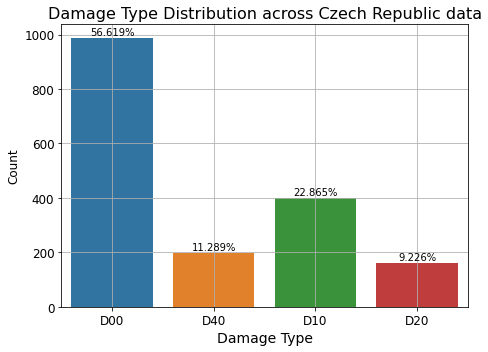

In [ ]:
# plotting countplot for Czech Republic data
countplot_generator(czech_label, 'Damage Type Distribution across Czech Republic data')

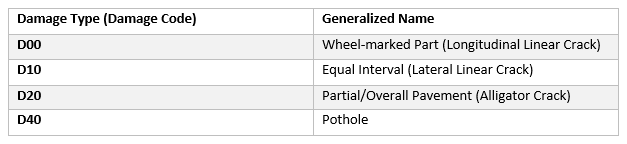

**Observation -** Among all the images, for which annotations are given there are a lot of images with the Damage Type 'D00' (almost 57%). Which typically means 'wheet-marked part'. And there is highly imbalanceness across the data, as we can see in the countplot.

### Damage Type Analysis (India's data) -

In [ ]:
# getting indexes where damage types meet with the specified condition (Step - 1)

india_idx, india_label = cleaner(india_dataset)
print(len(india_idx))
print(len(india_label))

3223
6831


**Observation -** There are only 3223 images for which annotations (damage types) are given.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


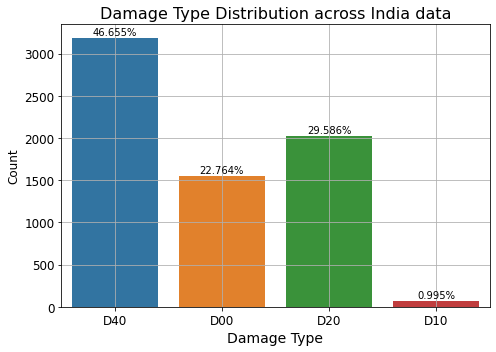

In [ ]:
# plotting countplot for India data
countplot_generator(india_label, 'Damage Type Distribution across India data')

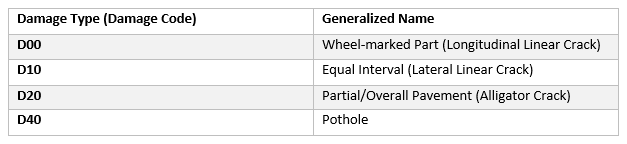

**Observation -** Among all the images, for which annotations are given there are a lot of images with the Damage Type 'D40' (almost 47%). Which typically means 'pot hole'. And there is highly imbalanceness across the data, as we can see in the countplot. Another thing to note down for Indian damage data there are approx 1% images represent damage type 'D10', which means 'equal interval'.

### Damage Type Analysis (Japan's data) -

In [ ]:
# getting indexes where damage types meet with the specified condition (Step - 1)

japan_idx, japan_label = cleaner(japan_dataset)
print(len(japan_idx))
print(len(japan_label))

7900
16470


**Observation -** There are only 7900 images for which annotations (damage types) are given.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


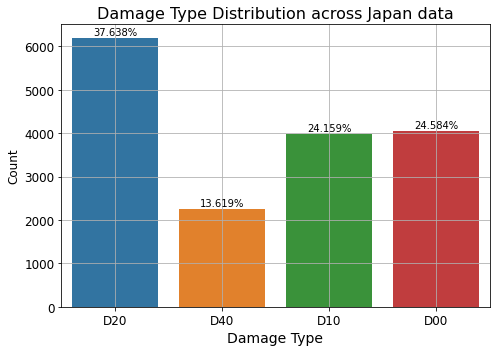

In [ ]:
# plotting countplot for Japan data
countplot_generator(japan_label, 'Damage Type Distribution across Japan data')

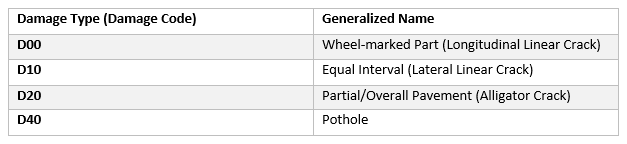

**Observation -** Among all the images, for which annotations are given there are a lot of images with the Damage Type 'D20' (almost 38%). Which typically means 'partial pavement, overall pavement', also represented by 'Aligator crack'. And there is highly imbalanceness across the data, as we can see in the countplot.

### Damage Type Analysis (For all data) -

In [ ]:
# getting indexes where damage types meet with the specified condition (Step - 1)

idx, label = cleaner(dataset)
print(len(idx))
print(len(label))

12195
25046


**Observation -** There are only 12195 images for which annotations (damage types) are given.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


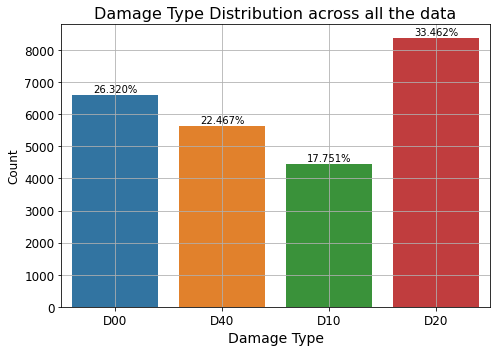

In [ ]:
# plotting countplot across all the data
countplot_generator(label, 'Damage Type Distribution across all the data')

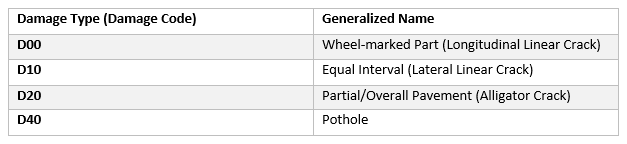

**Observation -** This plot shows the overall conclusion of all the above individual plots. So for each damage type we have a good chunk of data. Which means, any sensible model can achieve good performance.

In [ ]:
# keeping selected rows (step - 1 result) in the dataset (step - 2)

new_dataset = dataset.loc[idx]
new_dataset = new_dataset.reset_index(drop=True)
new_dataset.shape

(12195, 2)

In [ ]:
new_dataset.head()

,images,annotations
0,train/Czech/images/Czech_000006.jpg,train/Czech/annotations/xmls/Czech_000006.xml
1,train/Czech/images/Czech_000010.jpg,train/Czech/annotations/xmls/Czech_000010.xml
2,train/Czech/images/Czech_000020.jpg,train/Czech/annotations/xmls/Czech_000020.xml
3,train/Czech/images/Czech_000021.jpg,train/Czech/annotations/xmls/Czech_000021.xml
4,train/Czech/images/Czech_000022.jpg,train/Czech/annotations/xmls/Czech_000022.xml


In [ ]:
new_dataset.to_csv('drive/MyDrive/RDD/final_dataset.csv', index=False)

### Creating bounding boxes based on annotations for some sample images - 

In [ ]:
# creating sample dataset

sampled_dataset = new_dataset.sample(50)
sampled_dataset = sampled_dataset.reset_index(drop=True)
sampled_dataset.head()

,images,annotations
0,train/India/images/India_002070.jpg,train/India/annotations/xmls/India_002070.xml
1,train/Japan/images/Japan_011077.jpg,train/Japan/annotations/xmls/Japan_011077.xml
2,train/Japan/images/Japan_004448.jpg,train/Japan/annotations/xmls/Japan_004448.xml
3,train/India/images/India_003507.jpg,train/India/annotations/xmls/India_003507.xml
4,train/Japan/images/Japan_007342.jpg,train/Japan/annotations/xmls/Japan_007342.xml


In [ ]:
def draw_bb(image_file, xml_file):
  '''
  This function is used to create bounding boxes and putting text(label) on the image, based on annotations.
  Reference : https://github.com/sekilab/RoadDamageDetector/blob/master/RoadDamageDatasetTutorial.ipynb
  Parameters : image_file - string, xml_file - string
  Return : img - a image
  '''
  img = cv2.imread(image_file)
  infile_xml = open(xml_file)
  tree = ET.parse(infile_xml)
  root = tree.getroot()

  for obj in root.iter('object'):
    cls_name = obj.find('name').text
    if ('D00' in cls_name) or ('D10' in cls_name) or ('D20' in cls_name) or ('D40' in cls_name):
      xmlbox = obj.find('bndbox')
      xmin = int(xmlbox.find('xmin').text)
      xmax = int(xmlbox.find('xmax').text)
      ymin = int(xmlbox.find('ymin').text)
      ymax = int(xmlbox.find('ymax').text)

      font = cv2.FONT_HERSHEY_SIMPLEX

      # put text
      cv2.putText(img,cls_name,(xmin,ymin-10),font,1,(0,255,0),2,cv2.LINE_AA)

      # draw bounding box
      cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0,255,0),3)

  return img

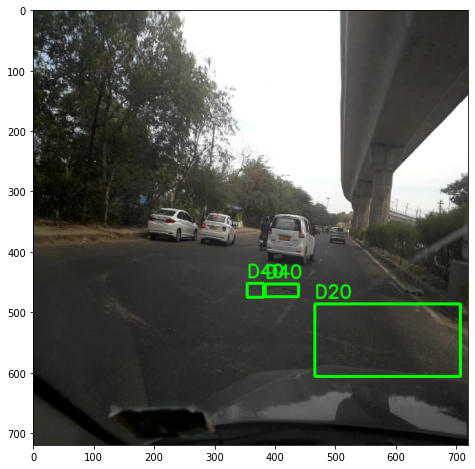

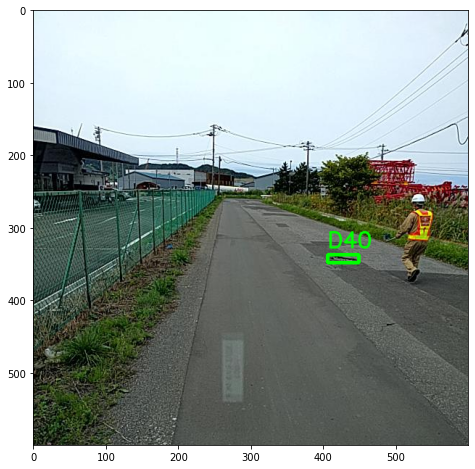

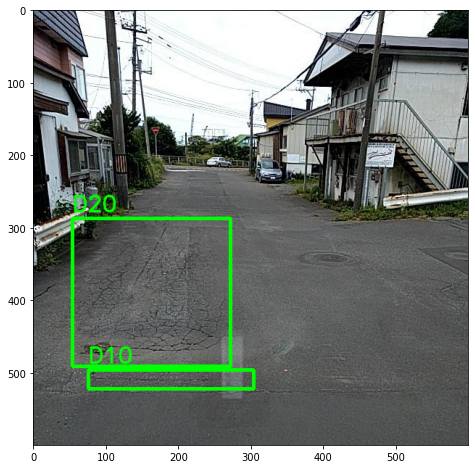

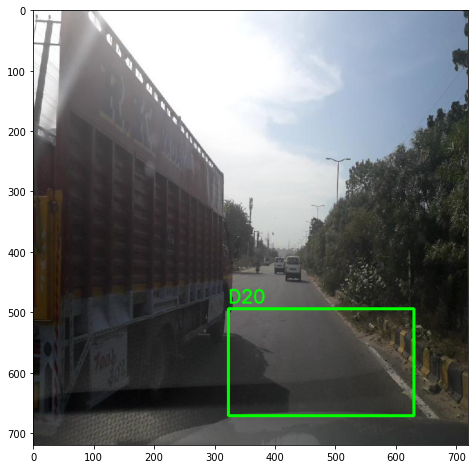

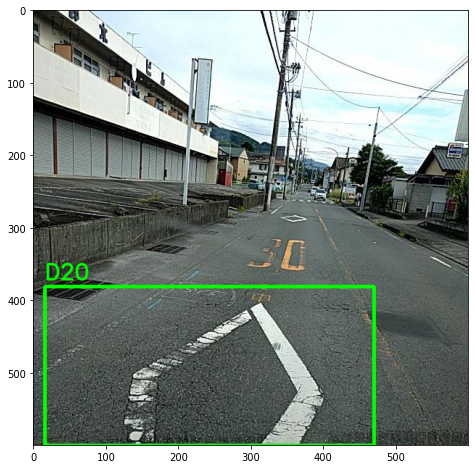

...

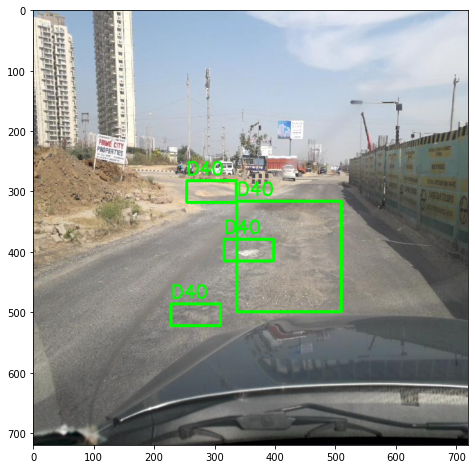

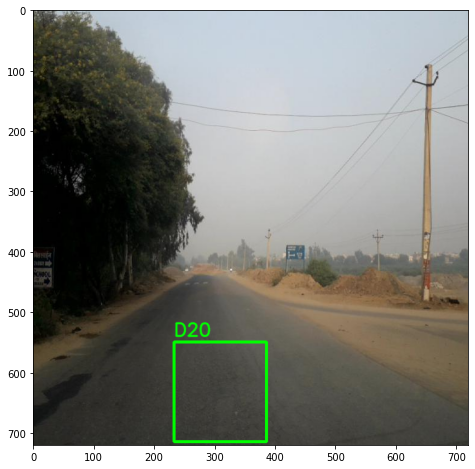

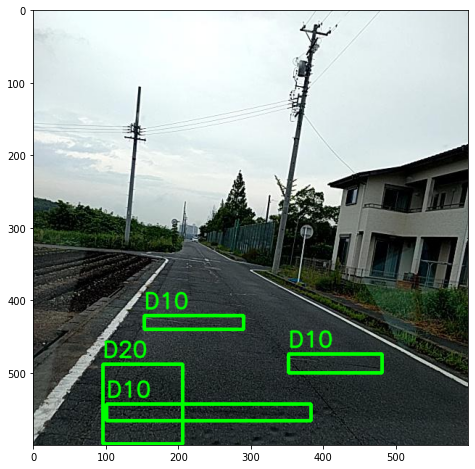

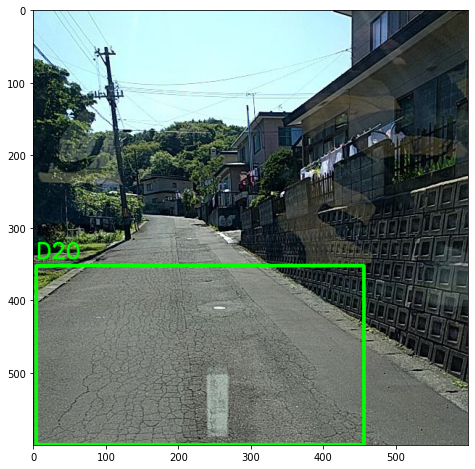

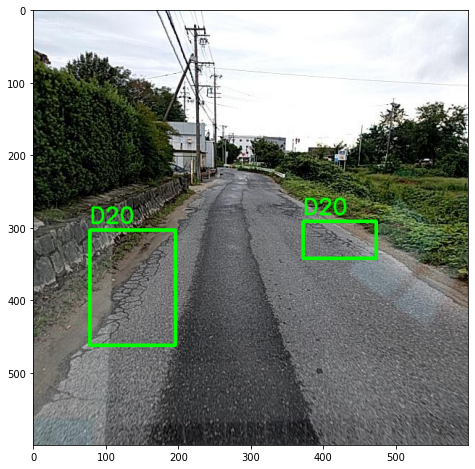

In [ ]:
# These images just used to demonstrate a specific damage type on the road
# creating bounding boxes with damage types for multiple images
# Reference : https://stackoverflow.com/questions/41210823/using-plt-imshow-to-display-multiple-images

for i in range(sampled_dataset.shape[0]):
  img = draw_bb(sampled_dataset['images'].tolist()[i], sampled_dataset['annotations'].tolist()[i])
  plt.figure(figsize=(12,8))
  plt.subplot(1,1,1)
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

That's it for the EDA, now next is **Data Preparation**.